In [1]:
%matplotlib widget
%load_ext autoreload
%autoreload 2
import sys
sys.path.append('../')
sys.path.append('../../utils/')
from fig12code import *
import copy
from IPython.display import Image, display

## The correction can be applied using 
```
lake_object = dictobj(read_melt_lake_h5('<lake_file_name>.h5'))
depht_data_corrected, = surrf_correction(lake_object, correct=True)
```

The `lake_object` is also updated with the corrected data after `calling surrf_correction()`.

In [2]:
# input data
df_melling = pd.read_csv('data_melling_2024.csv',index_col=False)
df_fricker = pd.read_csv('data_fricker_2021.csv',index_col=False)


Antarctic lake 1
(Fricker et al., 2021)


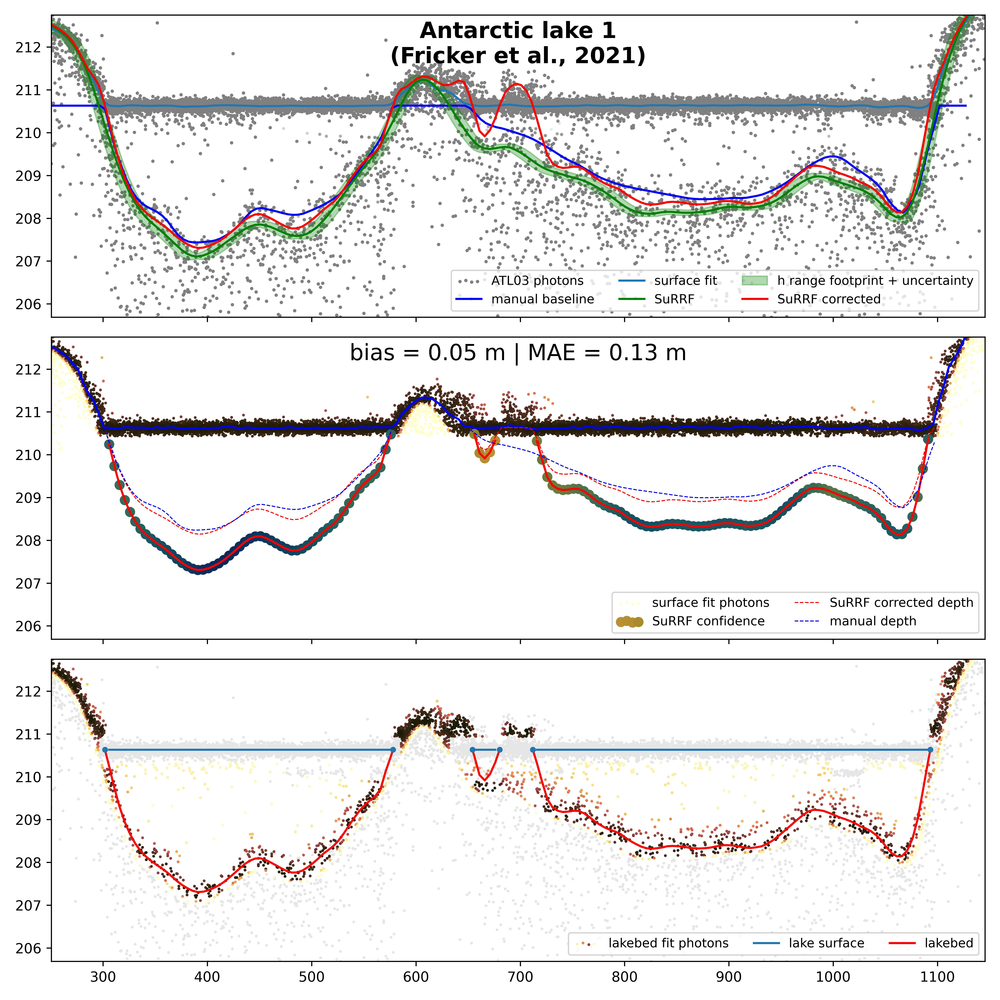


Antarctic lake 2
(Fricker et al., 2021)


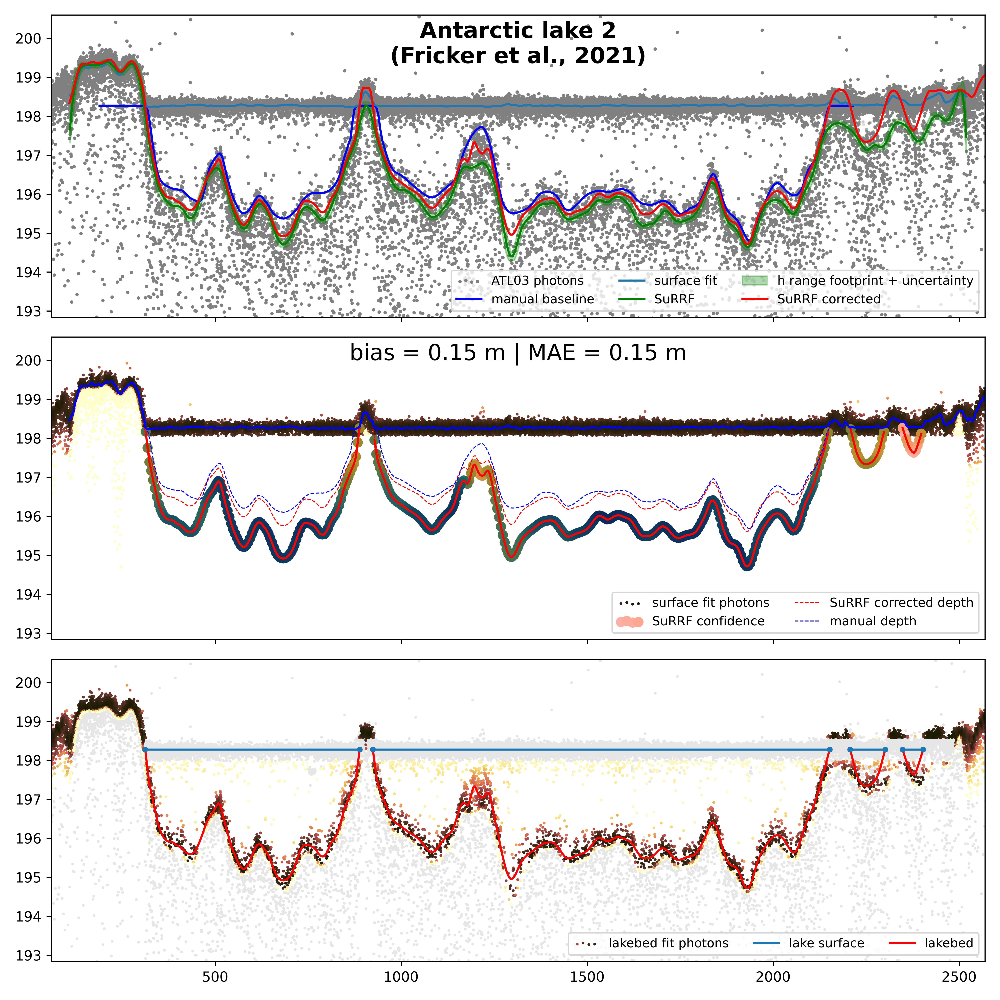


Antarctic lake 3
(Fricker et al., 2021)


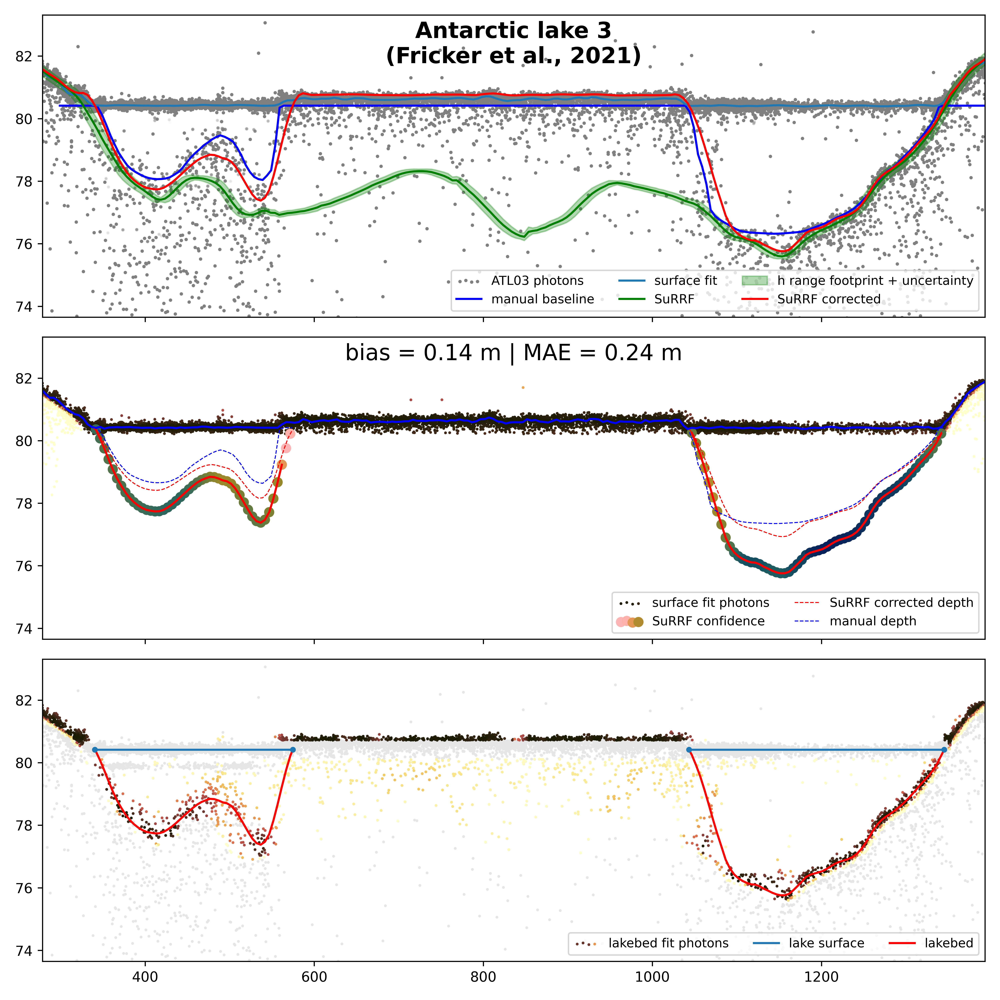


Antarctic lake 4
(Fricker et al., 2021)


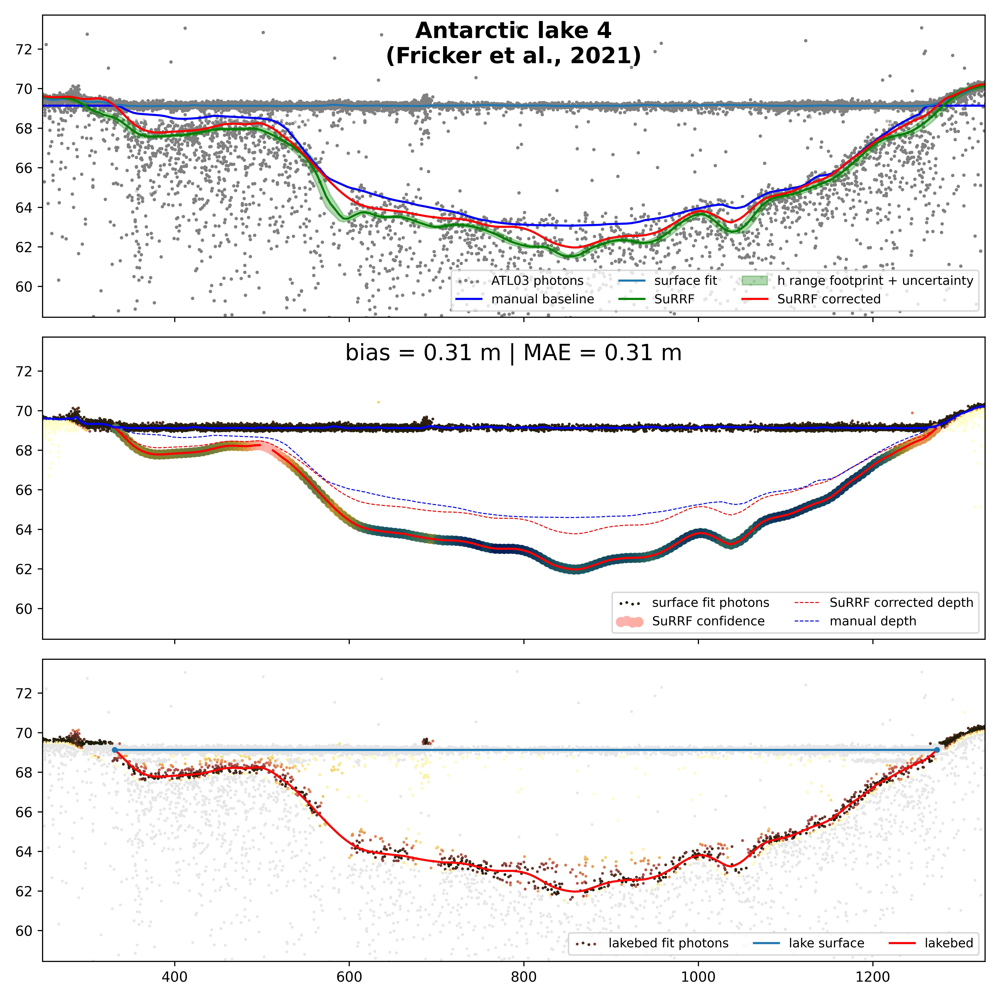


Greenland lake 1
(Melling et al., 2024)


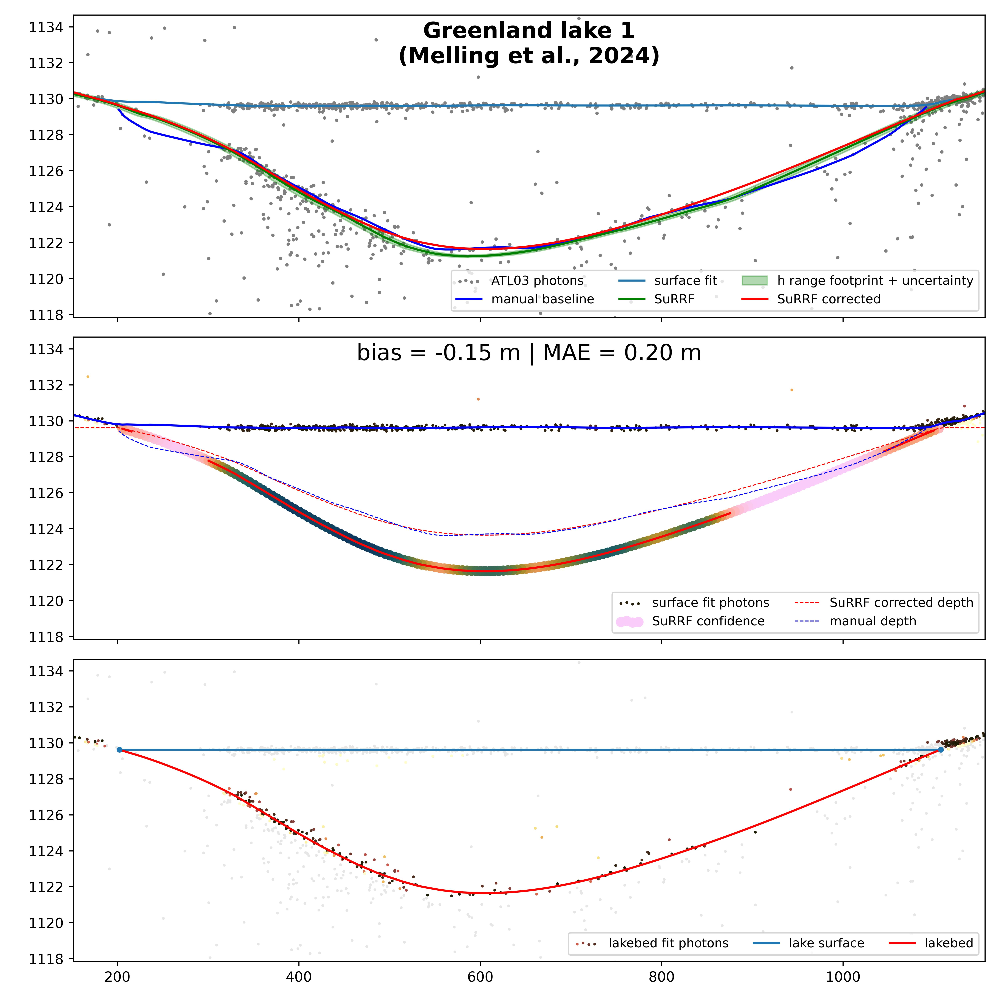


Greenland lake 2
(Melling et al., 2024)


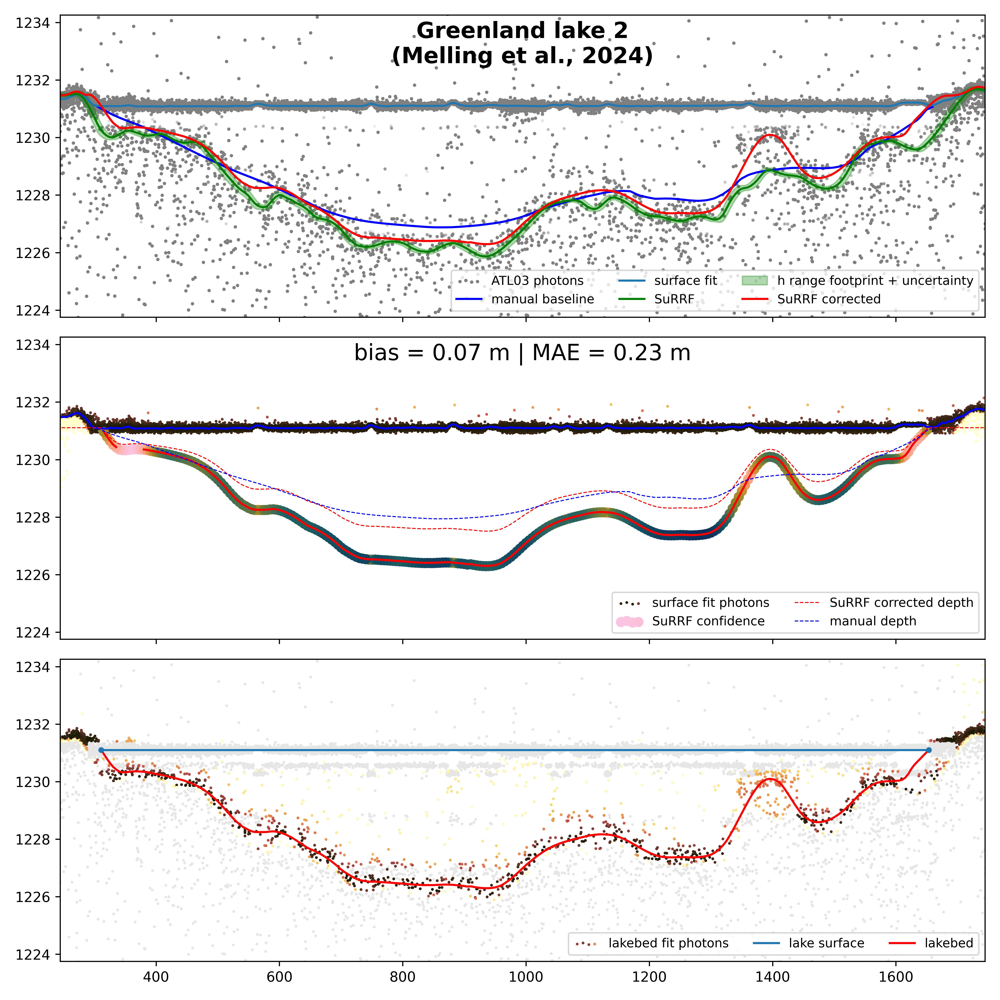


Greenland lake 3
(Melling et al., 2024)


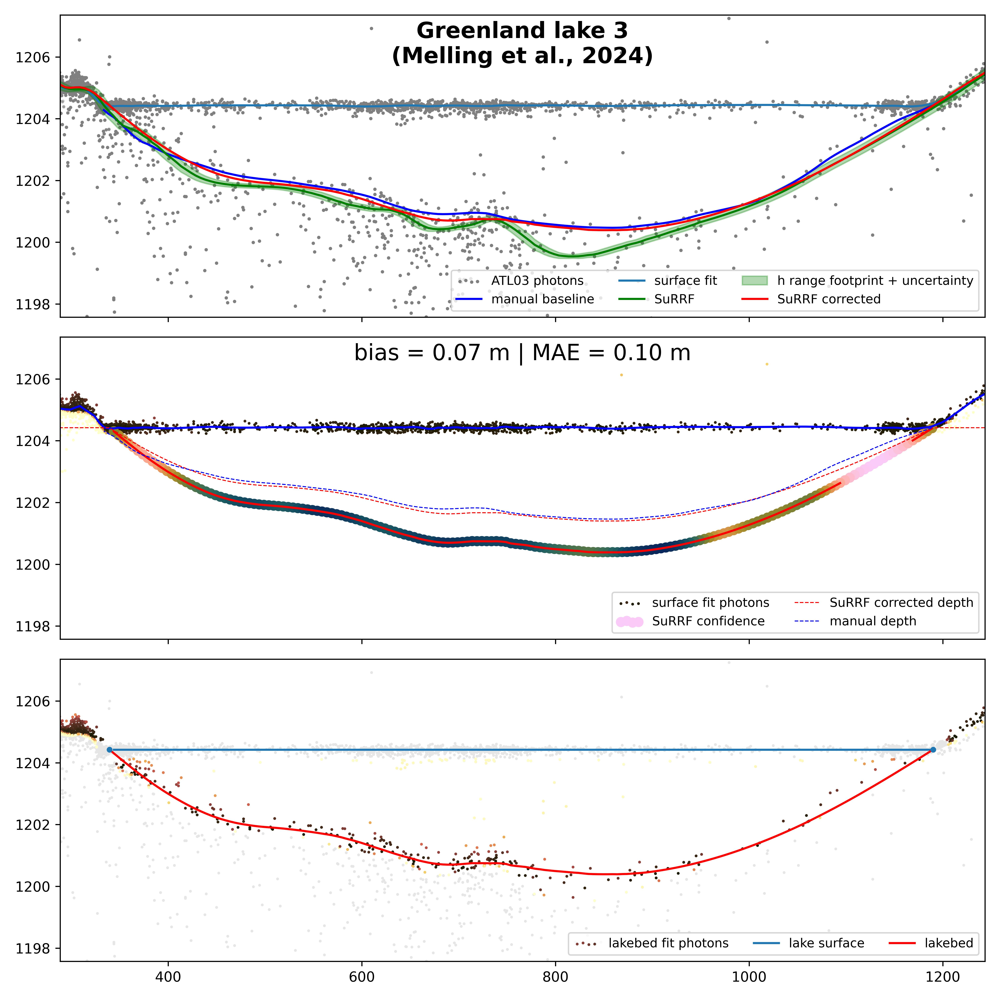


Greenland lake 4
(Melling et al., 2024)


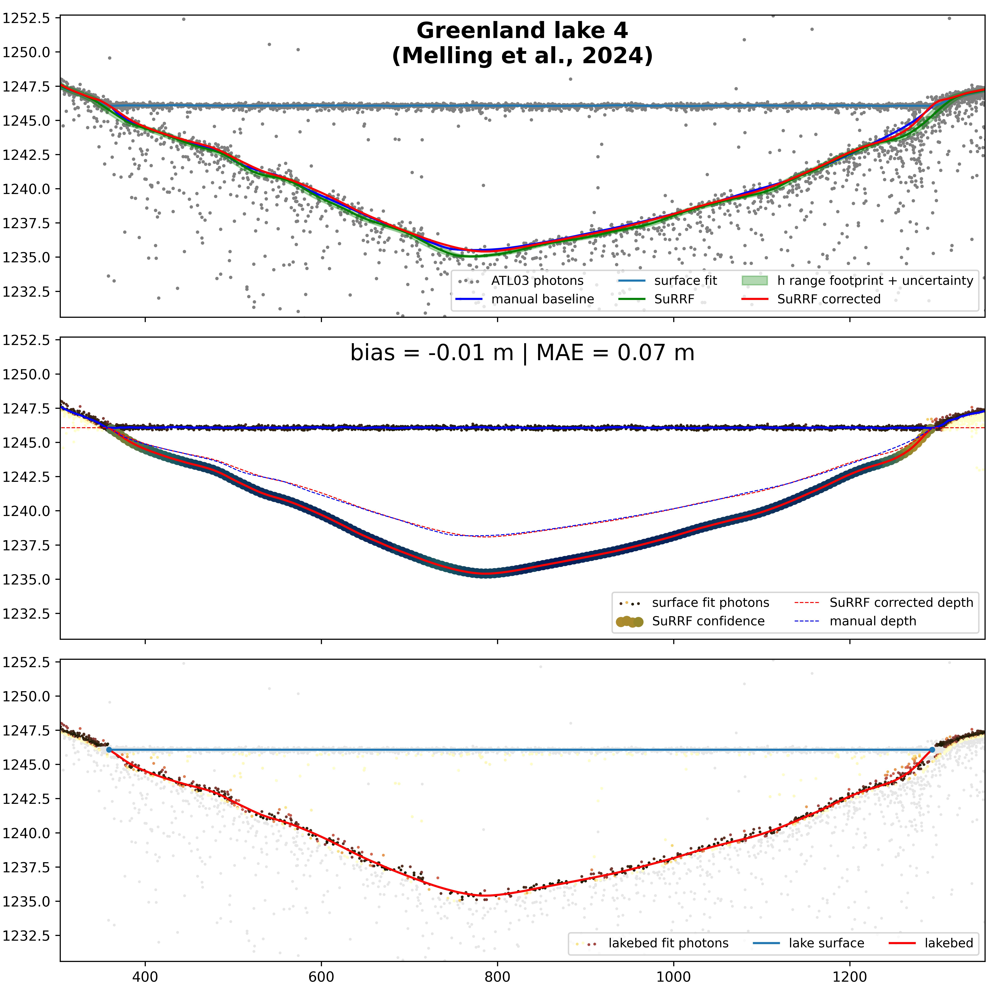


Greenland lake 5
(Melling et al., 2024)


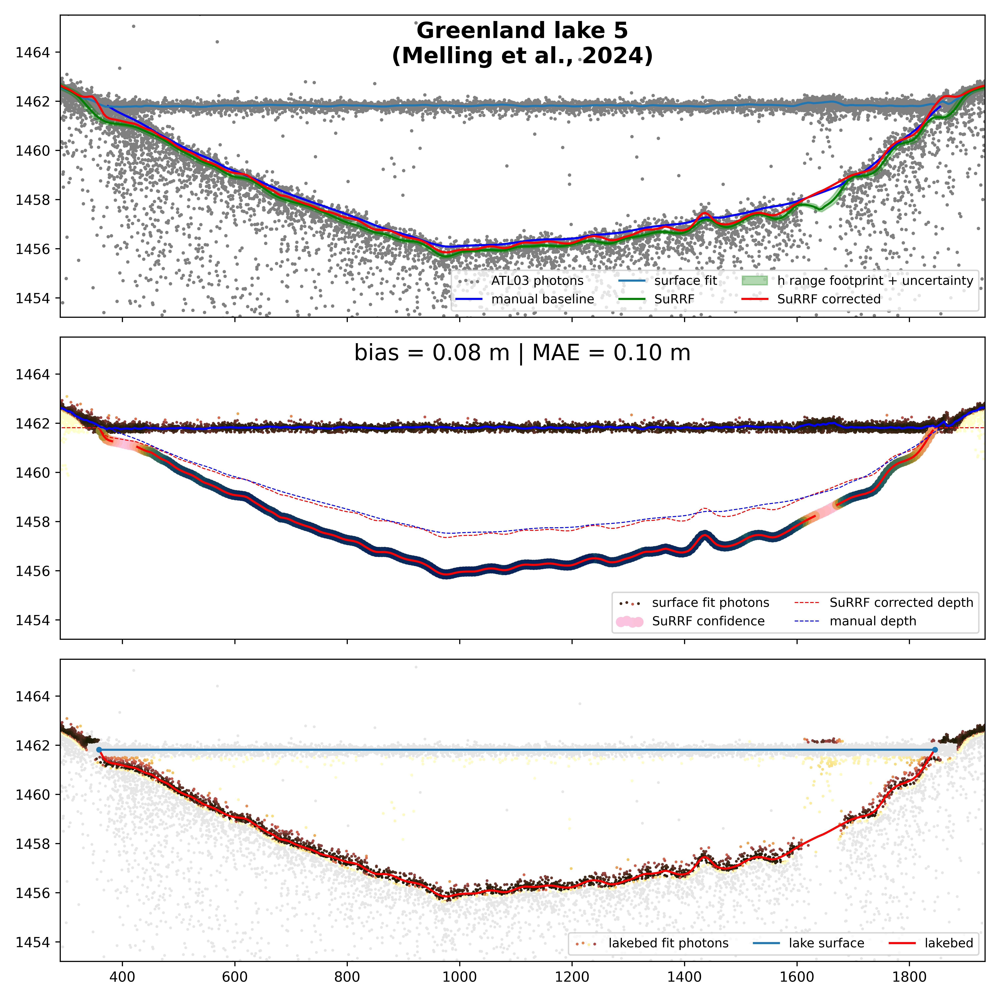

In [9]:
dfis = []
tries = np.arange(9)
for itry in np.arange(9):

    ref_idx = 1.336
    
    idxs = [x for x in enumerate(np.hstack((np.arange(1,5), np.arange(1,6))))]
    iplot, ilake = idxs[itry]
    
    source = 'fricker' if iplot < 4 else 'melling'
    source_txt = 'Fricker et al., 2021' if source=='fricker' else 'Melling et al., 2024'
    dfm = df_fricker if source=='fricker' else df_melling
    lake_file_name = 'lake_amery_fricker_%i.h5' % ilake if source=='fricker' else 'lake_greenland_melling_%i.h5' % ilake
    location = 'Antarctic' if source=='fricker' else 'Greenland'
    tit = '%s lake %i\n(%s)' % (location, ilake, source_txt)
    print('\n%s' % tit)
    
    selector = dfm.lake_id == ilake
    dfi_out = dfm[selector].copy()
    lk = dictobj(read_melt_lake_h5(lake_file_name))
    hsurf = lk.surface_elevation
    photon_data = lk.photon_data
    dfd = lk.depth_data
    
    lknew = copy.deepcopy(lk)
    # run SuRRF on new data
    # print('first pass')
    # dfdc, df_fit, df_nosurf, init_guess = surrf_correction(lknew, correct=False)
    dfdc = lknew.depth_data.copy()
    
    # print('second pass')
    lk_corr = copy.deepcopy(lknew)
    #-------------------------------------------
    dfdcc, df_fit, df_nosurf, init_guess, extent = surrf_correction(lk_corr, correct=True)
    #-------------------------------------------
    dfi_out['surrf_corr'] = np.interp(dfi_out.dist_along_track_m, dfdcc.xatc, dfdcc.depth, left=np.nan, right=np.nan)
    dfi_out['surrf_corr_conf'] = np.interp(dfi_out.dist_along_track_m, dfdcc.xatc, dfdcc.conf, left=np.nan, right=np.nan)
    dfis.append(dfi_out)

    dfi = dfi_out.copy()
    
    # print('DONE!')

    # plt.close('all')

    xl = (dfd.xatc[dfd.depth>0].min()-50, dfd.xatc[dfd.depth>0].max()+50)
    yl = (hsurf-lk.max_depth*1.4*ref_idx, hsurf+lk.max_depth*0.6*ref_idx)
    
    fig, axs = plt.subplots(figsize=[10,10], nrows=3, sharex=True, sharey=True)
    
    df = lk_corr.photon_data
    
    ###########################################################
    ax = axs[0]
    ax.scatter(df.xatc[~df.is_afterpulse], df.h[~df.is_afterpulse], s=2, color='gray', alpha=np.clip(1-df[~df.is_afterpulse].prob_afterpulse,0,1), label='ATL03 photons')
    ax.plot(dfi.dist_along_track_m, hsurf-dfi.manual*ref_idx, 'b-', label='manual baseline')
    ax.plot(dfdc.xatc, dfdc.h_fit_surf, color='C0', label='surface fit')
    ax.plot(dfdc.xatc, dfdc.h_fit_bed, color='g', ls='-', label='SuRRF')
    ax.text(0.5, 0.98, tit, ha='center', va='top', fontsize=16, transform=ax.transAxes, fontweight='bold')
    
    footprint_diameter = 11 # icesat-2 footprint diameter in meters
    ref_idx = 1.336 # refractive index for the speed of light in 0 degree C freshwater
    photon_precision_time = 800e-12 # Single-photon time-of-flight precision: 800 ps
    speed_of_light = 299792458 # m/s in vacuum
    def get_footprint_hrange(x):
        footprint_border = np.asarray([x.xatc - footprint_diameter/2, x.xatc + footprint_diameter/2])
        return np.abs(np.diff(np.interp(footprint_border, dfd.xatc, dfd.h_fit_bed))[0])
    hrange_footprint_atl03 = dfd.apply(get_footprint_hrange, axis=1)
    hrange_footprint_depth = hrange_footprint_atl03 / ref_idx
    uncert_atl03 = speed_of_light * photon_precision_time / 2
    uncert_depth = uncert_atl03 / ref_idx
    
    total_spread_atl03 = hrange_footprint_atl03 + uncert_atl03
    total_spread_depth = hrange_footprint_depth + uncert_depth
    
    upper_lim_atl03 = dfd.h_fit_bed + total_spread_atl03 / 2
    lower_lim_atl03 = dfd.h_fit_bed - total_spread_atl03 / 2 
    
    ax.fill_between(dfd.xatc, lower_lim_atl03, upper_lim_atl03, color='g', alpha=0.3, label='h range footprint + uncertainty')
    ax.plot(dfdcc.xatc, dfdcc.h_fit_bed, color='r', label='SuRRF corrected')
    ax.legend(loc='lower right', ncols=3, fontsize=9, scatterpoints=4)
    
    ###########################################################
    ax = axs[1]
    ax.scatter(df_fit.xatc, df_fit.h, s=1, c=df_fit.snr, cmap=cmc.lajolla, label='surface fit photons')
    d0 = dfdc.depth.copy()
    d1 = dfdcc.depth.copy()
    d0[d0==0] = np.nan
    d1[d1==0] = np.nan
    
    conft = 0.15
    d1[dfdcc.conf<conft] = np.nan
    ax.plot(dfdcc.xatc, hsurf - d1 * ref_idx, 'r-')
    dfpp = dfdcc.sort_values(by='conf')
    dfpp.loc[dfpp.depth==0,'xatc'] = np.nan
    ax.scatter(dfpp.xatc, dfpp.h_fit_bed, s=40, c=dfpp.conf, cmap=cmc.batlow_r, vmin=0, vmax=1, label='SuRRF confidence')
    ax.plot(dfdcc.xatc, dfdcc.h_fit_surf, color='b')
    
    dfi.loc[(dfi.surrf_corr==0) & (dfi.manual==0)] = np.nan
    bias = np.nanmean(dfi.surrf_corr - dfi.manual)
    mae = np.nanmean(np.abs(dfi.surrf_corr - dfi.manual))
    ax.text(0.5, 0.98, 'bias = %.2f m | MAE = %.2f m' % (bias, mae), ha='center', va='top', fontsize=16, transform=ax.transAxes)

    ax.plot(dfi.dist_along_track_m, hsurf-dfi.surrf_corr, color='r', ls='--', lw=0.7, label='SuRRF corrected depth')
    ax.plot(dfi.dist_along_track_m, hsurf-dfi.manual, color='b', ls='--', lw=0.7, label='manual depth')

    ax.legend(loc='lower right', ncols=2, fontsize=9, scatterpoints=4)
    
    ###########################################################
    ax = axs[2]
    ax.scatter(df.xatc, df.h, s=1, color=[0.9]*3)
    ax.scatter(df_nosurf[~df_nosurf.is_afterpulse].xatc, df_nosurf[~df_nosurf.is_afterpulse].h, s=1, c=df_nosurf[~df_nosurf.is_afterpulse].snr, 
               cmap=cmc.lajolla, label='lakebed fit photons')
    ax.scatter(df_nosurf[df_nosurf.is_afterpulse].xatc, df_nosurf[df_nosurf.is_afterpulse].h, s=1, color='red')
    
    cols_sel = ['xatc','h_fit_bed','surf_elev','depth']
    dfp = dfdcc.copy()
    dfp['surf_elev'] = lk_corr.surface_elevation
    dfp = dfp[cols_sel]
    xinter, hinter = intersection(dfp.xatc, dfp.surf_elev, dfp.xatc, dfp.h_fit_bed)
    intersection_pts = pd.DataFrame({'xatc': xinter, 'h_fit_bed': hinter, 'depth': 1e-5, 'conf': 0.5})
    dfp = pd.concat((dfp, intersection_pts)).sort_values(by='xatc').reset_index(drop=True)
    dfp.loc[dfp.depth==0, 'xatc'] = np.nan
    ax.plot(dfp.xatc, dfp.surf_elev, color='C0', label='lake surface')
    ax.plot(dfp.xatc, dfp.h_fit_bed, color='r', label='lakebed')
    ax.scatter(intersection_pts.xatc, intersection_pts.h_fit_bed, s=10, color='C0', zorder=20)

    ax.legend(loc='lower right', ncols=3, fontsize=9, scatterpoints=4)
    
    ax.set_xlim(xl)
    ax.set_ylim(yl)
    fig.tight_layout()

    figname = 'correction_figs/%s_lake%i.jpg' % (location, ilake)
    fig.savefig(figname, dpi=600)

    plt.close(fig)
    display(Image(figname))


In [6]:
# antdfs = pd.concat(dfis[:4]).reset_index(drop=True)
# antdfs = antdfs[~antdfs.iloc[:,4:].isnull().all(1)].reset_index(drop=True)
# antdfs['lake_id'] = antdfs.lake_id.astype(np.int8)
# antdfs.to_csv('data_fricker_2021_surrfcorrected.csv', index=False)

In [8]:
# gredfs = pd.concat(dfis[4:]).reset_index(drop=True)
# gredfs = gredfs[~gredfs.iloc[:,4:].isnull().all(1)].reset_index(drop=True)
# gredfs['lake_id'] = gredfs.lake_id.astype(np.int8)
# gredfs.to_csv('data_melling_2024_surrfcorrected.csv', index=False)

In [ ]:
itry = 4
ref_idx = 1.336
    
idxs = [x for x in enumerate(np.hstack((np.arange(1,5), np.arange(1,6))))]
iplot, ilake = idxs[itry]

source = 'fricker' if iplot < 4 else 'melling'
source_txt = 'Fricker et al., 2021' if source=='fricker' else 'Melling et al., 2024'
dfm = df_fricker if source=='fricker' else df_melling
lake_file_name = 'lake_amery_fricker_%i.h5' % ilake if source=='fricker' else 'lake_greenland_melling_%i.h5' % ilake
location = 'Antarctic' if source=='fricker' else 'Greenland'
tit = '%s lake %i\n(%s)' % (location, ilake, source_txt)
print('\n%s' % tit)

selector = dfm.lake_id == ilake
dfi = dfm[selector].copy()
lk = dictobj(read_melt_lake_h5(lake_file_name))
hsurf = lk.surface_elevation
photon_data = lk.photon_data
dfd = lk.depth_data

lknew = copy.deepcopy(lk)
#-------------------------------------------
# run SuRRF on new data
# print('first pass')
# dfdc, df_fit, df_nosurf, init_guess = surrf_correction(lknew, correct=False)
dfdc = lknew.depth_data.copy()

# print('second pass')
lk_corr = copy.deepcopy(lknew)

self = lk_corr 
final_resolution=5.0
ext_buffer=200.0
correct=True

# function for robust (iterative) nonparametric regression (to fit surface and bed of lake)
def robust_npreg(df_fit, ext, n_iter=10, poly_degree=1, len_xatc_min=100, n_points=[300,100], 
    resolutions=[30,5], stds=[20,6], ext_buffer=250.0, full=False, init=None, vweight_start=10):
    
    h_list = []
    x_list = []
    n_phots = np.linspace(n_points[0], n_points[1], n_iter)
    resols = np.linspace(resolutions[0], resolutions[1], n_iter)
    n_stds = np.hstack((np.linspace(stds[0], stds[1], n_iter-1), stds[1]))
    minx = np.min(np.array(ext))
    maxx = np.max(np.array(ext))

    # take into account initial guess, if specified (needs to be dataframe with columns 'xatc' and 'h')
    if (init is not None) and (len(init) > 0): 
        range_vweight = vweight_start
        df_fit['heights_fit'] = np.interp(df_fit.xatc, init.xatc, init.h, left=np.nan, right=np.nan)
        vert_weight = (1.0 - np.clip((np.abs(df_fit.h-df_fit.heights_fit)/range_vweight),0,1)**3 )**3
        vert_weight[np.isnan(vert_weight)] = 0.01
        df_fit['vert_weight'] = vert_weight
    else: 
        df_fit['vert_weight'] = 1.0
    
    for it in range(n_iter):
        
        n_phot = n_phots[it]
        res = resols[it]
        n_std = n_stds[it]
        evaldf = pd.DataFrame(np.arange(minx-ext_buffer,maxx+ext_buffer+res,step=res),columns=['xatc'])
        h_arr = np.full_like(evaldf.xatc,fill_value=np.nan)
        stdev_arr = np.full_like(evaldf.xatc,fill_value=np.nan)
        df_fit_nnz = df_fit[df_fit.vert_weight > 1e-3].copy()

        # for every point at which to evaluate local fit
        for i,x in enumerate(evaldf.xatc):
            
            # look for the closest n_phot photons around the center point for local polynomial fit
            idx_closest_photon = np.argmin(np.abs(np.array(df_fit_nnz.xatc - x)))
            n_phot_each_side = int(np.ceil(n_phot / 2))
            idx_start = np.clip(idx_closest_photon - n_phot_each_side, 0, None)
            idx_end = np.clip(idx_closest_photon + n_phot_each_side +1, None, len(df_fit_nnz)-1)
            xatc_start = df_fit_nnz.iloc[idx_start].xatc
            xatc_end = df_fit_nnz.iloc[idx_end].xatc
            len_xatc = xatc_end - xatc_start

            # if the fit for n_phot does not span at least len_xatc_min, then make the segment longer
            if len_xatc < len_xatc_min: 
                xstart = x - len_xatc_min/2
                xend = x + len_xatc_min/2
                idx_start = np.min((int(np.clip(np.argmin(np.abs(np.array(df_fit_nnz.xatc - xstart))), 0, None)), idx_start))
                idx_end = np.max((int(np.clip(np.argmin(np.abs(np.array(df_fit_nnz.xatc - xend))), None, len(df_fit_nnz)-1)), idx_end))

            # make a data frame with the data for the fit
            dfi = df_fit_nnz.iloc[idx_start:idx_end].copy()

            # tricube weights for xatc distance from evaluation point
            maxdist = np.nanmax(np.abs(dfi.xatc - x))
            dfi['weights'] = (1.0-(np.abs(dfi.xatc-x)/(1.00001*maxdist))**3)**3

            # also weight by the SNR values and the vertical distance from previous fit 
            if it < (n_iter-1):  # ignore SNR values in the last pass
                dfi.weights *= dfi.snr
            if (init is not None) | (it > 0):  # vertical weights are only available after first iteration or with initial guess
                dfi.weights *= dfi.vert_weight

            # do the polynomial fit
            try: 
                reg_model = np.poly1d(np.polyfit(dfi.xatc, dfi.h, poly_degree, w=dfi.weights))
                h_arr[i] = reg_model(x)
                stdev_arr[i] = np.average(np.abs(dfi.h - reg_model(dfi.xatc)), weights=dfi.weights) # use weighted mean absolute error
            except:  # if polynomial fit does not converge, use a weighted average
                h_arr[i] = np.average(dfi.h,weights=dfi.weights)
                stdev_arr[i] = np.average(np.abs(dfi.h - h_arr[i]), weights=dfi.weights) # use weighted mean absolute error
            
        evaldf['h_fit'] = h_arr
        evaldf['stdev'] = stdev_arr
        
        # interpolate the fit and residual MAE to the photon-level data
        df_fit['heights_fit'] = np.interp(df_fit.xatc, evaldf.xatc, evaldf.h_fit, left=-9999, right=-9999)
        df_fit['std_fit'] = np.interp(df_fit.xatc, evaldf.xatc, evaldf.stdev)

        # compute tricube weights for the vertical distance for the next iteration
        width_vweight = np.clip(n_std*df_fit.std_fit,0.0, 10.0)
        if 'min_vertrange' in df_fit.keys():
            width_vweight = pd.concat((width_vweight, df_fit.min_vertrange),axis=1).max(axis=1)
        df_fit['vert_weight'] = (1.0 - np.clip((np.abs(df_fit.h-df_fit.heights_fit)/width_vweight),0,1)**3 )**3
        df_fit.loc[df_fit.heights_fit == -9999, 'vert_weight'] = 0.0 # give small non-zero weight for leading and trailing photons
        
        if full:
            h_list.append(h_arr)
            x_list.append(evaldf.xatc)

        # print('iteration %i / %i' % (it+1, n_iter), end='\r')

    if full:
        return evaldf, df_fit, x_list, h_list
    else:
        return evaldf, df_fit

# remove scattering data if correct is true and lake already has depth data
# this allows the function to be used for the initial surrf guess as well as the correction
iscorrection = correct and hasattr(self, 'depth_data')
if iscorrection:
    width_water = 0.3
    vweight_start_surf = 3
    vweight_start_bed = 3
    dfd = self.depth_data.copy()
    hsurf = self.surface_elevation
    h_surf = self.surface_elevation # used two different names, too lazy to change right now...
    xbounds = list(intersection(dfd.xatc, dfd.h_fit_bed, dfd.xatc, np.ones_like(dfd.h_fit_bed)*hsurf)[0])
    smaller = dfd.xatc - xbounds[0]
    smaller = smaller[smaller<0]
    idx = len(smaller-1)
    if dfd.h_fit_bed.iloc[idx] < dfd.h_fit_bed.iloc[idx+1]:
        xbounds = xbounds[1:]
    if (len(xbounds) % 2) != 0:
        xbounds = xbounds[:-1]
    ext = [xbounds[iseg:iseg+2] for iseg in np.arange(0,len(xbounds),2)]     
    # if len(ext) == 0:
    #     return None

    footprint_diameter = 11 # icesat-2 footprint diameter in meters
    ref_idx = 1.336 # refractive index for the speed of light in 0 degree C freshwater
    photon_precision_time = 800e-12 # Single-photon time-of-flight precision: 800 ps
    speed_of_light = 299792458 # m/s in vacuum
    def get_footprint_hrange(x):
        footprint_border = np.asarray([x.xatc - footprint_diameter/2, x.xatc + footprint_diameter/2])
        return np.abs(np.diff(np.interp(footprint_border, dfd.xatc, dfd.h_fit_bed))[0])
    hrange_footprint_atl03 = dfd.apply(get_footprint_hrange, axis=1)
    hrange_footprint_depth = hrange_footprint_atl03 / ref_idx
    uncert_atl03 = speed_of_light * photon_precision_time / 2
    uncert_depth = uncert_atl03 / ref_idx
    
    total_spread_atl03 = hrange_footprint_atl03 + uncert_atl03
    total_spread_depth = hrange_footprint_depth + uncert_depth
    upper_lim_atl03 = dfd.h_fit_bed + total_spread_atl03 / 2
    lower_lim_atl03 = dfd.h_fit_bed - total_spread_atl03 / 2

    df = self.photon_data.copy()
    df['min_vertrange'] = np.interp(df.xatc, dfd.xatc, total_spread_atl03/2)
    df['lower_lim'] = np.interp(df.xatc, dfd.xatc, lower_lim_atl03)
    df['correction_keep'] = df.h >= df.lower_lim
    df['bedfit'] = np.interp(df.xatc, dfd.xatc, dfd.h_fit_bed)
    diff = np.abs(np.clip(df.h - df.bedfit, None, 0))
    wd = df.bedfit - df.lower_lim
    df['reduce_snr_correction'] = (1- np.clip(np.abs(diff)/(1.00001*wd),0,1)**2)**3

    # use old estimate as initial guess, rename column to match FLUID bathymetry peak labels
    init_guess = dfd[['xatc', 'h_fit_bed']].rename(columns={'h_fit_bed': 'h'})

else:
    # get the relevant data (photon-level dataframe, water surface elevation estimate, extent estimate)
    width_water = 0.35
    vweight_start_surf = 10
    vweight_start_bed = 10
    ext = self.surface_extent_detection
    # if len(ext) == 0:
    #     return None
    df = self.photon_data.copy()
    h_surf = self.surface_elevation
    
    init_guess_bed = pd.DataFrame(self.detection_2nd_returns)
    
df.sort_values(by='xatc', inplace=True, ignore_index=True)

# if ('sat_ratio' in df.keys()) & (not (correct and hasattr(self, 'depth_data'))): 
#     df['is_afterpulse'] = df.prob_afterpulse>np.random.uniform(0,1,len(df))
if 'sat_ratio' in df.keys(): 
    df['is_afterpulse'] = df.prob_afterpulse>np.random.uniform(0,1,len(df))

# fit the surface elevation only to photons just around and above the estimated water surface elevation
ext_buffer_meters = 30
df['in_extent'] = False
df['in_extent_buffer'] = False
for extseg in ext:
    df.loc[(df.xatc >= extseg[0]) & (df.xatc <= extseg[1]),'in_extent'] = True
ext_buffer_water = [[xt[0]-ext_buffer_meters, xt[1]+ext_buffer_meters] for xt in ext]
for extseg in ext_buffer_water:
    df.loc[(df.xatc >= extseg[0]) & (df.xatc <= extseg[1]),'in_extent_buffer'] = True
surffit_selector = (((df.h > (h_surf-0.2)) | (~df.in_extent_buffer)) & (df.snr > 0.2))  |  ((df.h > (h_surf-0.15)) & (df.h < (h_surf+0.15)))
df_fit = df[surffit_selector].copy()
if 'reduce_snr_correction' in df_fit.keys():
    df_fit.snr *= df_fit['reduce_snr_correction']
min_len = 5 if iscorrection else 20
npts = [100, 50] if iscorrection else [300,100]
start_resolution = 5 if iscorrection else 20
evaldf_surf, df_fit_surf = robust_npreg(df_fit, ext, n_iter=10, poly_degree=1, len_xatc_min=min_len, vweight_start=vweight_start_surf, 
                                        n_points=npts, resolutions=[start_resolution,final_resolution], stds=[10,4], ext_buffer=ext_buffer+10.0)

# re-calculate water surface elevation based on fit
hist_res = 0.001
hist_smoothing = 0.05
bins = np.arange(h_surf-1, h_surf+1+hist_res, hist_res)
mids = bins[:-1] + np.diff(bins)
histvals = np.histogram(evaldf_surf.h_fit, bins=bins)[0]
hist_smooth = pd.Series(histvals).rolling(window=int(np.ceil(hist_smoothing/hist_res)),center=True, min_periods=1).mean()
surf_elev = mids[np.argmax(hist_smooth)]

# set the probability of photons being surface / water
df['prob_surf'] = 0
df.loc[df_fit_surf.index, 'prob_surf'] = df_fit_surf.vert_weight
df['is_signal'] = df.prob_surf > 0.0
df['surf_fit'] = np.interp(df.xatc, evaldf_surf.xatc, evaldf_surf.h_fit, left=np.nan, right=np.nan)

in_ext_and_water_range = (df['in_extent']  |  ((df['in_extent_buffer']) & (np.abs(df.surf_fit - surf_elev) < 0.275)))
df['is_water'] =  in_ext_and_water_range  &  ((((df.h - surf_elev) > (-width_water)) & (df.snr < 0.75)) | (np.abs(df.h - surf_elev) < width_water))

# get data frame with the water surface removed, and set a minimum for SNR, except for afterpulses
df_nosurf = df[(~df.is_water) & (df.h < (surf_elev + 30)) & (df.h > (surf_elev - 50))].copy()
min_snr = 0.2
df_nosurf['snr'] = min_snr + (1.0-min_snr)*df_nosurf.snr

# if correcting for scattering, take out the bottom scattering photons again
if 'reduce_snr_correction' in df_nosurf.keys():
        df_nosurf.snr *= df_nosurf['reduce_snr_correction']

# discard heavily saturated PMT ionization afterpulses (rarely an issue)
if 'sat_ratio' in df_nosurf.keys(): 
    df_nosurf = df_nosurf[(df_nosurf.sat_ratio < 3.5) | ((surf_elev - df_nosurf.h) < 12.0)]
    df_nosurf.loc[df_nosurf.is_afterpulse, 'snr'] = 0.0

if iscorrection:
    df_nosurf['init_guess'] = np.interp(df_nosurf.xatc, dfd.xatc, dfd.h_fit_bed, left=np.nan, right=np.nan)
else:
    # get an initial guess for the nonparametric regression fit to the lake bed (from secondary peaks during detection stage)
    init_guess_bed = init_guess_bed[(init_guess_bed.prom > 0.3) & (init_guess_bed.h < (surf_elev-2.0))]
    init_guess_surf = pd.DataFrame({'xatc': evaldf_surf.xatc, 'h': evaldf_surf.h_fit})
    init_guess_surf = init_guess_surf[init_guess_surf.h > (surf_elev+width_water)]
    init_guess = pd.concat((init_guess_bed, init_guess_surf), ignore_index=True).sort_values(by='xatc')
    init_guess_hsmooth = init_guess.h.rolling(window=5, center=True, min_periods=1).mean()
    is_bed = init_guess.h < surf_elev
    init_guess.loc[is_bed, 'h'] = init_guess_hsmooth[is_bed]
    
    if len(init_guess.h) > 0:
        df_nosurf['init_guess'] = np.interp(df_nosurf.xatc, init_guess.xatc, init_guess.h, left=np.nan, right=np.nan)
    else:
        df_nosurf['init_guess'] = np.ones_like(df_nosurf.xatc) * (surf_elev - 2.0)

# re-calculate densities
df_nosurf = df_nosurf[df_nosurf.snr > 0].copy()
df_new = df_nosurf.copy()
df_new = get_signal(df_new, n_iter=100, h_thresh=[30,0.5], xatc_win=[40,5])
df_new = get_density(df_new, segment_length=20, signal_width=0.2, aspect=30, K_phot=30, frac_noise=0.05)
df_nosurf['snr'] = df_new.density

# if correcting for scattering, take out the bottom scattering photons again
if 'reduce_snr_correction' in df_nosurf.keys():
        df_nosurf.snr *= df_nosurf['reduce_snr_correction']

# reduce the snr between the lake surface and initial guess, to mitigate the effect of subsurface scattering
# (very occasionally, this can remove signal)
reduce_snr_bedbuffer = df_nosurf.min_vertrange if 'min_vertrange' in df_nosurf.keys() else 1.0
reduce_overshoot = 1.0 if 'min_vertrange' in df_nosurf.keys() else 1.5
reduce_snr = (df_nosurf.h > (df_nosurf.init_guess + reduce_snr_bedbuffer)) & (df_nosurf.h < surf_elev)
df_nosurf['reduce_snr_factor'] = 1.0
reduce_snr_factor = 1.0 - reduce_overshoot*((df_nosurf.h[reduce_snr] - (df_nosurf.init_guess[reduce_snr] + reduce_snr_bedbuffer)) / 
                            (surf_elev - (df_nosurf[reduce_snr].init_guess + reduce_snr_bedbuffer)))
reduce_snr_factor = np.clip(reduce_snr_factor, 0, 1)
df_nosurf.loc[reduce_snr, 'reduce_snr_factor'] = reduce_snr_factor
df_nosurf.loc[reduce_snr, 'snr'] *= df_nosurf.reduce_snr_factor
df_nosurf = df_nosurf[df_nosurf.snr > 0].copy()

start_resolution = 5 if iscorrection else 20
len_xatc_min = 50 if iscorrection else 100
stds = [7, 4] if iscorrection else [10, 3]
# weakphots = [50,30] if iscorrection else [100,50]
# strongphots = [100,50] if iscorrection else [200,100]
weakphots = [100,50]
strongphots = [200,100]

# fit lakebed surface 
npts = weakphots if self.beam_strength=='weak' else strongphots
evaldf, df_fit_bed = robust_npreg(df_nosurf, ext, n_iter=20, poly_degree=3, len_xatc_min=len_xatc_min,
                                          n_points=npts, resolutions=[start_resolution,final_resolution], stds=stds, 
                                          ext_buffer=ext_buffer, full=False, init=init_guess, vweight_start=vweight_start_bed
                                 )

# add probability of being lake bed for each photon
df['prob_bed'] = 0
df.loc[df_fit_bed.index, 'prob_bed'] = df_fit_bed.vert_weight
df.loc[df.prob_bed>0.0,'is_signal'] = True
df.loc[df.h > surf_elev, 'prob_bed'] = 0
df.prob_bed /= df.prob_bed.max()

# compile the results from surface and bed fitting into one data frame
evaldf['h_fit_surf'] = np.interp(evaldf.xatc, evaldf_surf.xatc, evaldf_surf.h_fit)
evaldf['stdev_surf'] = np.interp(evaldf.xatc, evaldf_surf.xatc, evaldf_surf.stdev)
evaldf['is_water'] = np.abs(evaldf.h_fit_surf - surf_elev) < width_water

df['bed_fit'] = np.interp(df.xatc, evaldf.xatc, evaldf.h_fit, left=np.nan, right=np.nan)
df.loc[df.bed_fit > surf_elev,'prob_surf'] = 0.0

# estimate the quality of the signal 
std_range = 2.0  # calculate the photon density within this amount of residual MAEs for the bed density
qual_smooth = 40  # along-track meters for smoothing the the quality measure 
evaldf['lower'] = evaldf.h_fit-std_range*evaldf.stdev  # lower threshold for bed photon density 
evaldf['upper'] = evaldf.h_fit+std_range*evaldf.stdev  # uppper threshold for bed photon density / lower threshold for lake interior 
evaldf['hrange_bed'] = evaldf.upper - evaldf.lower  # the elevation range over which to calculate bed photon density
evaldf['hrange_int'] = np.clip((surf_elev - evaldf.upper) * 0.5 , 0.5, None) # the elevation range over which to calculate interior photon density
evaldf['upper_int'] = evaldf.h_fit + evaldf.hrange_bed/2 + evaldf.hrange_int # upper threshold for lake interior photon density

# initialize photon counts per depth measurement point, and get photon data frame with afterpulses removed
num_bed = np.zeros_like(evaldf.xatc)
num_interior = np.zeros_like(evaldf.xatc)
df_nnz = df.copy()
if 'is_afterpulse' in df_nnz.keys(): 
    df_nnz = df_nnz[~df_nnz.is_afterpulse]

# loop through measurement points and count photons in the lake bed and lake interior ranges
for i in range(len(evaldf)):
    vals = evaldf.iloc[i]
    in_xatc = (df_nnz.xatc > (vals.xatc-final_resolution)) & (df_nnz.xatc < (vals.xatc+final_resolution))
    in_range_bed = in_xatc & (df_nnz.h > vals.lower) & (df_nnz.h < vals.upper)
    in_range_interior = in_xatc & (df_nnz.h > vals.upper) & (df_nnz.h < vals.upper_int)
    num_bed[i] = np.sum(in_range_bed)
    num_interior[i] = np.sum(in_range_interior)

# calculate the density ratio weight between the lake bed and the lake interior for each point
# is zero if bed density is less or equal to interior density
# approaches 1 as bed density becomes >> interior density
# is 0 if there are no bed photons
# is 1 if there are bed photons, but no interior photons
evaldf['nph_bed'] = num_bed
evaldf['nph_int'] = num_interior
evaldf.loc[evaldf.nph_bed == 0, 'nph_bed'] = np.nan
evaldf['density_ratio'] = 1 - np.clip((evaldf.nph_int / evaldf.hrange_int)/(evaldf.nph_bed / evaldf.hrange_bed), 0, 1)
evaldf.loc[evaldf.h_fit > surf_elev,'density_ratio'] = 1.0 
evaldf.loc[evaldf.nph_bed.isna(), 'density_ratio'] = 0.0

# get the width ratio weight 
# becomes 0 when the bed fit range includes the surface
# becomes 1 when the interior range is at least as large as the lake bed fit range
width_ratio = np.clip((evaldf.h_fit_surf+std_range*evaldf.stdev_surf - evaldf.upper),0,None) / (1.0*evaldf.hrange_bed)
width_ratio[evaldf.h_fit > surf_elev] = 1.0
evaldf['width_ratio'] = np.clip(width_ratio, 0, 1)

# smooth out the weights a little 
wdw = int(np.ceil(qual_smooth/final_resolution))
evaldf['density_ratio'] = evaldf.density_ratio.rolling(window=3*wdw, win_type='gaussian', min_periods=1, center=True).mean(std=wdw/2)
evaldf['width_ratio'] = evaldf.width_ratio.rolling(window=3*wdw, win_type='gaussian', min_periods=1, center=True).mean(std=wdw/2)

# get the confidence in the measurement as the product between the two
evaldf['conf'] = evaldf.density_ratio * evaldf.width_ratio

# calculate the water depth
evaldf['depth'] = np.clip(surf_elev - evaldf.h_fit, 0, None) / 1.336
evaldf.loc[(~evaldf.is_water) & (evaldf.depth > 0.0), 'conf'] = 0.0
evaldf.loc[~evaldf.is_water, 'depth'] = 0.0

# multiply probability of bed by condifence in measurement
df.prob_bed *= np.interp(df.xatc, evaldf.xatc, evaldf.conf, left=0.0, right=0.0)

# get the overall lake quality
df_bed = evaldf[(evaldf.h_fit < surf_elev) & (evaldf.h_fit < evaldf.h_fit_surf)].copy()
nbins = 300
counts = np.zeros((len(df_bed), nbins))

for i in range(len(df_bed)):
    vals = df_bed.iloc[i]
    in_xatc = (df_nnz.xatc > (vals.xatc-final_resolution/2)) & (df_nnz.xatc < (vals.xatc+final_resolution/2))
    thisdf = df_nnz[in_xatc]
    # bins = np.linspace(vals.h_fit-vals.depth, surf_elev+vals.depth, nbins+1)
    hrng = vals.h_fit_surf - vals.h_fit
    bins = np.linspace(vals.h_fit-hrng, vals.h_fit_surf+hrng, nbins+1)
    hist = np.histogram(thisdf.h, bins=bins)[0]
    counts[i,:] = hist

scaled_hist = np.sum(counts, axis=0)
scaled_smooth = pd.Series(scaled_hist).rolling(window=int(nbins/10), win_type='gaussian', min_periods=1, center=True).mean(std=nbins/100)
df_dens = pd.DataFrame({'x': np.linspace(-1,2,nbins), 'n': scaled_smooth})
n_bedpeak = np.interp(0.0, df_dens.x, df_dens.n)
df_dens_int = df_dens[(df_dens.x > 0) & (df_dens.x < 1)].copy()
# n_saddle = np.min(df_dens_int.n)
n_saddle = np.mean(df_dens_int.n[df_dens_int.n < np.percentile(df_dens_int.n, 25)])
depth_quality = np.clip(n_bedpeak / n_saddle - 2, 0, None)
depth_quality_sort = np.clip(n_bedpeak / n_saddle, 0, None)

evaldf['h_fit_bed'] = evaldf.h_fit
evaldf['std_bed'] = evaldf.stdev
evaldf['std_surf'] = evaldf.stdev_surf
df['xatc_10m'] = np.round(df.xatc, -1)
df_spatial = df[['lat', 'lon', 'xatc', 'xatc_10m']][df.is_signal].groupby('xatc_10m').median()
evaldf['lat'] = np.interp(evaldf.xatc, df_spatial.xatc, df_spatial.lat, right=np.nan, left=np.nan)
evaldf['lon'] = np.interp(evaldf.xatc, df_spatial.xatc, df_spatial.lon, right=np.nan, left=np.nan)
evaldf = evaldf[~evaldf.lat.isna()]
evaldf = evaldf[~evaldf.lon.isna()]

# self.photon_data['prob_surf'] = df.prob_surf
# self.photon_data['prob_bed'] = df.prob_bed
# self.photon_data['is_signal'] = df.is_signal
# self.photon_data['is_afterpulse'] = df.is_afterpulse
hfitsurf_all = evaldf.h_fit_surf.copy()
prob_adjust_elev = 1 - np.interp(df.xatc, evaldf.xatc, np.clip((np.abs(hfitsurf_all-surf_elev)-0.03)/0.2, 0, 1))
leftx = df.xatc - evaldf[evaldf.depth > 0].xatc.min()
rightx = evaldf[evaldf.depth > 0].xatc.max() - df.xatc
prob_adjust_sides = np.clip(np.min(np.vstack((leftx, rightx)), axis=0)/50, 0, 1)
prob_adjust = prob_adjust_elev * prob_adjust_sides
df.prob_surf *= prob_adjust
df.prob_bed *= prob_adjust

hfitsurf_all = evaldf.h_fit_surf.copy()
prob_adjust_elev = 1 - np.clip((np.abs(hfitsurf_all-surf_elev)-0.03)/0.2, 0, 1)
prob_adjust_elev[evaldf.depth <= 0] = 1.0
evaldf.conf *= prob_adjust_elev

# save results to lake object
self.photon_data = df[list(set(list(self.photon_data.keys()) + ['prob_surf', 'prob_bed', 'is_signal', 'is_afterpulse'
                                                               ]))].sort_values(by='xatc').reset_index(drop=True)
self.depth_data = evaldf[['xatc', 'lat', 'lon', 'depth', 'conf', 'h_fit_surf', 'h_fit_bed', 'std_surf', 'std_bed']].copy()
self.surface_elevation = surf_elev
self.lake_quality = depth_quality
depth_quality_sort = 0.0 if np.isnan(depth_quality_sort) else depth_quality_sort
self.quality_sort = depth_quality_sort
hqdepth = evaldf.depth[(evaldf.conf>0.3) & (np.abs(evaldf.h_fit_surf - surf_elev) < 0.25) & (evaldf.depth >= 0.0)]
self.max_depth = hqdepth.max() if len(hqdepth) > 0 else 0.0
if correct and hasattr(self, 'depth_data'):
    self.corrected = True
else:
    self.corrected = False

df_depth = evaldf[['xatc', 'lat', 'lon', 'depth', 'conf', 'h_fit_surf', 'h_fit_bed', 'std_surf', 'std_bed']].copy()
#return df_depth, df_fit, df_nosurf, init_guess, ext

In [ ]:
df_new

In [ ]:
figname = 'correction_figs/%s_lake%i.jpg' % (location, ilake)
figname

In [ ]:
plt.close('all')

xl = (dfd.xatc[dfd.depth>0].min()-200, dfd.xatc[dfd.depth>0].max()+200)
yl = (hsurf-lk.max_depth*1.2*ref_idx, hsurf+lk.max_depth*0.7*ref_idx)

fig, axs = plt.subplots(figsize=[10,10], nrows=3, sharex=True, sharey=True)

df = lk_corr.photon_data

###########################################################
ax = axs[0]
ax.scatter(df.xatc[~df.is_afterpulse], df.h[~df.is_afterpulse], s=2, color='gray', alpha=1-df[~df.is_afterpulse].prob_afterpulse)
ax.plot(dfdc.xatc, dfdc.h_fit_surf, color='C0')
ax.plot(dfdc.xatc, dfdc.h_fit_bed, color='g', ls='-')
ax.plot(dfdcc.xatc, dfdcc.h_fit_bed, color='r')
ax.plot(dfi.dist_along_track_m, hsurf-dfi.manual*ref_idx, 'b-')
ax.text(0.5, 0.98, tit, ha='center', va='top', fontsize=16, transform=ax.transAxes, fontweight='bold')

###########################################################
ax = axs[1]
ax.scatter(df_fit.xatc, df_fit.h, s=1, c=df_fit.snr, cmap=cmc.lajolla)
d0 = dfdc.depth.copy()
d1 = dfdcc.depth.copy()
d0[d0==0] = np.nan
d1[d1==0] = np.nan

conft = 0.3
d1[dfdcc.conf<conft] = np.nan
ax.plot(dfdcc.xatc, hsurf - d1 * ref_idx, 'r-')
dfpp = dfdcc.sort_values(by='conf')
dfpp.loc[dfpp.depth==0,'xatc'] = np.nan
ax.scatter(dfpp.xatc, dfpp.h_fit_bed, s=40, c=dfpp.conf, cmap=cmc.batlow_r, vmin=0, vmax=1)
ax.plot(dfdcc.xatc, dfdcc.h_fit_surf, color='b')

dfi['surrf_corr'] = np.interp(dfi.dist_along_track_m, dfdcc.xatc, dfdcc.depth, left=np.nan, right=np.nan)
dfi.loc[(dfi.surrf_corr==0) & (dfi.manual==0)] = np.nan
bias = np.nanmean(dfi.surrf_corr - dfi.manual)
mae = np.nanmean(np.abs(dfi.surrf_corr - dfi.manual))
ax.text(0.5, 0.98, 'bias = %.2f m | MAE = %.2f m' % (bias, mae), ha='center', va='top', fontsize=16, transform=ax.transAxes)

###########################################################
ax = axs[2]
ax.scatter(df.xatc, df.h, s=1, color=[0.9]*3)
ax.scatter(df_nosurf[~df_nosurf.is_afterpulse].xatc, df_nosurf[~df_nosurf.is_afterpulse].h, s=1, c=df_nosurf[~df_nosurf.is_afterpulse].snr, cmap=cmc.lajolla)
ax.scatter(df_nosurf[df_nosurf.is_afterpulse].xatc, df_nosurf[df_nosurf.is_afterpulse].h, s=1, color='red')

cols_sel = ['xatc','h_fit_bed','surf_elev','depth']
dfp = dfdcc.copy()
dfp['surf_elev'] = lk_corr.surface_elevation
dfp = dfp[cols_sel]
xinter, hinter = intersection(dfp.xatc, dfp.surf_elev, dfp.xatc, dfp.h_fit_bed)
intersection_pts = pd.DataFrame({'xatc': xinter, 'h_fit_bed': hinter, 'depth': 1e-5, 'conf': 0.5})
dfp = pd.concat((dfp, intersection_pts)).sort_values(by='xatc').reset_index(drop=True)
dfp.loc[dfp.depth==0, 'xatc'] = np.nan
ax.plot(dfp.xatc, dfp.surf_elev, color='C0')
ax.plot(dfp.xatc, dfp.h_fit_bed, color='r')
ax.scatter(intersection_pts.xatc, intersection_pts.h_fit_bed, s=10, color='C0', zorder=20)

ax.set_xlim(xl)
ax.set_ylim(yl)
fig.tight_layout()

In [ ]:
dfi

In [ ]:
dfp = dfdcc.copy()
dfp['surf_elev'] = lk_corr.surface_elevation

In [ ]:
xinter, hinter = intersection(dfp.xatc, dfp.surf_elev, dfp.xatc, dfp.h_fit_bed)


In [ ]:
itry = 5

ref_idx = 1.336

idxs = [x for x in enumerate(np.hstack((np.arange(1,5), np.arange(1,6))))]
iplot, ilake = idxs[itry]

source = 'fricker' if iplot < 4 else 'melling'
source_txt = 'Fricker et al., 2021' if source=='fricker' else 'Melling et al., 2024'
dfm = df_fricker if source=='fricker' else df_melling
lake_file_name = 'lake_amery_fricker_%i.h5' % ilake if source=='fricker' else 'lake_greenland_melling_%i.h5' % ilake
location = 'Antarctic' if source=='fricker' else 'Greenland'

selector = dfm.lake_id == ilake
dfi = dfm[selector].copy()
lk = dictobj(read_melt_lake_h5(lake_file_name))
hsurf = lk.surface_elevation
photon_data = lk.photon_data
dfd = lk.depth_data

lknew = copy.deepcopy(lk)
#-------------------------------------------
# run SuRRF on new data
print('first pass')
# dfdc, df_fit, df_nosurf, init_guess = surrf_correction(lknew, correct=False)
dfdc = lknew.depth_data.copy()

print('second pass')
lk_corr = copy.deepcopy(lknew)
dfdcc, df_fit, df_nosurf, init_guess = surrf_correction(lk_corr, correct=True)

print('DONE!')

In [ ]:
dfi['surrf_corr'] = np.interp(dfi.dist_along_track_m, dfdcc.xatc, dfdcc.depth, left=np.nan, right=np.nan)
dfi.loc[(dfi.surrf_corr==0) & (dfi.manual==0)] = np.nan
np.nanmean(dfi.surrf_corr - dfi.manual)

In [ ]:
df

In [ ]:
df_new

In [ ]:
def _rect_inter_inner(x1, x2):
    n1 = x1.shape[0]-1
    n2 = x2.shape[0]-1
    X1 = np.c_[x1[:-1], x1[1:]]
    X2 = np.c_[x2[:-1], x2[1:]]
    S1 = np.tile(X1.min(axis=1), (n2, 1)).T
    S2 = np.tile(X2.max(axis=1), (n1, 1))
    S3 = np.tile(X1.max(axis=1), (n2, 1)).T
    S4 = np.tile(X2.min(axis=1), (n1, 1))
    return S1, S2, S3, S4


def _rectangle_intersection_(x1, y1, x2, y2):
    S1, S2, S3, S4 = _rect_inter_inner(x1, x2)
    S5, S6, S7, S8 = _rect_inter_inner(y1, y2)

    C1 = np.less_equal(S1, S2)
    C2 = np.greater_equal(S3, S4)
    C3 = np.less_equal(S5, S6)
    C4 = np.greater_equal(S7, S8)

    ii, jj = np.nonzero(C1 & C2 & C3 & C4)
    return ii, jj


def intersection(x1, y1, x2, y2):

    x1 = np.asarray(x1)
    x2 = np.asarray(x2)
    y1 = np.asarray(y1)
    y2 = np.asarray(y2)

    ii, jj = _rectangle_intersection_(x1, y1, x2, y2)
    n = len(ii)

    dxy1 = np.diff(np.c_[x1, y1], axis=0)
    dxy2 = np.diff(np.c_[x2, y2], axis=0)

    T = np.zeros((4, n))
    AA = np.zeros((4, 4, n))
    AA[0:2, 2, :] = -1
    AA[2:4, 3, :] = -1
    AA[0::2, 0, :] = dxy1[ii, :].T
    AA[1::2, 1, :] = dxy2[jj, :].T

    BB = np.zeros((4, n))
    BB[0, :] = -x1[ii].ravel()
    BB[1, :] = -x2[jj].ravel()
    BB[2, :] = -y1[ii].ravel()
    BB[3, :] = -y2[jj].ravel()

    for i in range(n):
        try:
            T[:, i] = np.linalg.solve(AA[:, :, i], BB[:, i])
        except:
            T[:, i] = np.Inf

    in_range = (T[0, :] >= 0) & (T[1, :] >= 0) & (
        T[0, :] <= 1) & (T[1, :] <= 1)

    xy0 = T[2:, in_range]
    xy0 = xy0.T
    return xy0[:, 0], xy0[:, 1]

In [ ]:
itry = 0

idxs = [x for x in enumerate(np.hstack((np.arange(1,5), np.arange(1,6))))]
iplot, ilake = idxs[itry]

source = 'fricker' if iplot < 4 else 'melling'
source_txt = 'Fricker et al., 2021' if source=='fricker' else 'Melling et al., 2024'
dfm = df_fricker if source=='fricker' else df_melling
lake_file_name = 'lake_amery_fricker_%i.h5' % ilake if source=='fricker' else 'lake_greenland_melling_%i.h5' % ilake
location = 'Antarctic' if source=='fricker' else 'Greenland'

selector = dfm.lake_id == ilake
dfi = dfm[selector].copy()
lk = dictobj(read_melt_lake_h5(lake_file_name))
hsurf = lk.surface_elevation
photon_data = lk.photon_data
dfd = lk.depth_data

plt.close('all')

fig, axs = plt.subplots(figsize=[9,5], ncols=2, sharex=True, sharey=True)

df = photon_data.copy()

###############################################################################
ax = axs[0]
ref_idx = 1.336
# df.loc[df.h < hsurf, 'h'] = hsurf - (hsurf - photon_data.loc[df.h < hsurf, 'h']) / ref_idx
ax.scatter(df.xatc, df.h, s=5, color='gray', edgecolors='none', alpha=0.3)

ax.plot(dfi.dist_along_track_m, hsurf-dfi.manual*ref_idx, color='b', label='manual', lw=1, zorder=10)
# ax.plot(dfd.xatc, hsurf-dfd.depth*ref_idx, color='r', label='SuRRF')
ax.plot(dfd.xatc, dfd.h_fit_bed, color='g', label='SuRRF')
#ax.plot(dfdc.xatc, hsurf-dfdc.depth*ref_idx, color='g', ls=':', label='SuRRF corrected')

footprint_diameter = 11 # icesat-2 footprint diameter in meters
ref_idx = 1.336 # refractive index for the speed of light in 0 degree C freshwater
photon_precision_time = 800e-12 # Single-photon time-of-flight precision: 800 ps
speed_of_light = 299792458 # m/s in vacuum
def get_footprint_hrange(x):
    footprint_border = np.asarray([x.xatc - footprint_diameter/2, x.xatc + footprint_diameter/2])
    return np.abs(np.diff(np.interp(footprint_border, dfd.xatc, dfd.h_fit_bed))[0])
hrange_footprint_atl03 = dfd.apply(get_footprint_hrange, axis=1)
hrange_footprint_depth = hrange_footprint_atl03 / ref_idx
uncert_atl03 = speed_of_light * photon_precision_time / 2
uncert_depth = uncert_atl03 / ref_idx

total_spread_atl03 = hrange_footprint_atl03 + uncert_atl03
total_spread_depth = hrange_footprint_depth + uncert_depth

upper_lim_atl03 = dfd.h_fit_bed + total_spread_atl03 / 2
lower_lim_atl03 = dfd.h_fit_bed - total_spread_atl03 / 2 

ax.fill_between(dfd.xatc, lower_lim_atl03, upper_lim_atl03, color='g', alpha=0.3, label='h range footprint + uncertainty')

xl = (dfd.xatc[dfd.depth>0].min()-50, dfd.xatc[dfd.depth>0].max()+50)
yl = (hsurf-lk.max_depth*1.2*ref_idx, hsurf+lk.max_depth*0.3*ref_idx)
ax.set_xlim(xl)
ax.set_ylim(yl)

###############################################################################
ax = axs[1]
df['lower_lim'] = np.interp(df.xatc, dfd.xatc, lower_lim_atl03)
df_rem = df[df.h >= df.lower_lim].copy()
df_rem['bedfit'] = np.interp(df_rem.xatc, dfd.xatc, dfd.h_fit_bed)
diff = np.abs(np.clip(df_rem.h - df_rem.bedfit, None, 0))
wd = df_rem.bedfit - df_rem.lower_lim
reduce = (1- np.clip(np.abs(diff)/(1.00001*wd),0,1)**2)**3
df_rem.snr *= reduce

# ax.scatter(df[df.h < df.lower_lim].xatc, df[df.h < df.lower_lim].h, s=5, color='gray', edgecolors='none', alpha=0.3)
ax.scatter(df_rem.xatc, df_rem.h, s=1, color='k', edgecolors='none', alpha=1)
ax.plot(dfi.dist_along_track_m, hsurf-dfi.manual*ref_idx, color='b', label='manual', lw=1, zorder=10)
#ax.plot(dfd.xatc, dfd.h_fit_bed, color='gray', label='SuRRF')

lknew = copy.deepcopy(lk)
# lknew.photon_data = df_rem

#-------------------------------------------
# run SuRRF on new data
dfdc = surrf_correction(lknew, correct=False)
#-------------------------------------------

ax.plot(dfdc.xatc, dfdc.h_fit_bed, color='r', ls='-', label='SuRRF corrected')

ax.set_xlim(xl)
ax.set_ylim(yl)

###############################################################################
ax = axs[0]
ax.plot(dfdc.xatc, dfdc.h_fit_bed, color='r', ls='-', label='SuRRF corrected')
ax.legend(loc='lower right', ncols=2, fontsize=6)

fig.tight_layout()

In [ ]:
hasattr(lk, 'depth_data')

In [ ]:
pd.concat((dfd.h_fit_surf, np.clip(dfd.depth, 0,10)),axis=1).max(axis=1)

In [ ]:
changes = np.hstack((np.diff(dfd.depth>0), False)) + np.hstack((False, np.diff(dfd.depth>0)))
hvals = np.asarray(dfd.h_fit_bed[changes])
xvals = np.asarray(dfd.xatc[changes])
print(xvals)
xbounds = []
for ichange in range(int(len(hvals)/2)):
    istart = ichange * 2
    h_frac = np.abs((hsurf - hvals[istart]) / (hvals[istart+1] - hvals[istart]))
    xbounds.append(xvals[istart] + (xvals[istart+1] - xvals[istart]) * h_frac)
xbounds = [xbounds[iseg:iseg+2] for iseg in np.arange(0,len(xbounds),2)]
xbounds

fig, ax = plt.subplots()
ax.scatter(df.xatc, df.h, s=1, color='k')
for seg in xbounds:
    ax.plot(seg, [hsurf]*2)

In [ ]:
df_r = df_rem.copy()
df_r['bedfit'] = np.interp(df_r.xatc, dfd.xatc, dfd.h_fit_bed)
diff = np.abs(np.clip(df_r.h - df_r.bedfit, None, 0))
wd = df_r.bedfit - df_r.lower_lim
reduce = (1- np.clip(np.abs(diff)/(1.00001*wd),0,1)**2)**3
df_r.snr *= reduce

fig, ax = plt.subplots()
ax.scatter(df_r.xatc[diff<=0], df_r.h[diff<=0], s=1, color='k')
ax.scatter(df_r[diff>0].xatc, df_r[diff>0].h, s=1, color='r', alpha=reduce[diff>0])
ax.plot(dfd.xatc, dfd.h_fit_bed, color='g', label='SuRRF', lw=0.5)
ax.plot(dfd.xatc, lower_lim_atl03, color='gray', label='lower lim', lw=0.5)
ax.set_xlim(xl)
ax.set_ylim(yl)

In [ ]:
wd = 2
x = np.linspace(-3, 3, 500)
y = (1- np.clip(np.abs(x)/(1.00001*wd),0,1)**2)**5 * (1- np.clip(np.abs(x)/(1.00001*wd),0,1))
y2 = 1- np.clip(np.abs(x)/(1.00001*wd),0,1)
# (1.0-(np.abs(dfi.xatc-x)/(1.00001*maxdist))**3)**3

fig, ax = plt.subplots()
ax.plot(x,y)
ax.plot(x,y2)
ax.plot(x,y*y2)

In [ ]:
fig, ax = plt.subplots()
ax.plot(dfdc.xatc, dfdc.h_fit_bed)

In [ ]:
footprint_diameter = 13
abs_slope = np.abs(np.diff(dfd.depth) / np.diff(dfd.xatc))
slp = (np.hstack((0,abs_slope)) + np.hstack((abs_slope, 0))) / 2
slp

In [ ]:
a = np.arange(1,5)
np.hstack((0,a))